Used potentials:

- Al: Al_mm.eam.fs
- Fe: Fe_mm.eaf.fs
- Cu: Cu_u6.eam
- Pb: Pb_Wang02.eam.fs (src: https://www.ctcms.nist.gov/potentials/entry/2018--Wang-K-Zhu-W-Xiang-M-et-al--Pb-II/)

In [171]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict

In [172]:
materials = ['Al', 'Fe', 'Cu', 'Pb']

lattice_constants = {
    'Al': 4.04527,
    'Fe': 2.855324,
    'Cu': 3.615,
    'Pb': 4.924
}

# lattice_constants = {
#     'Al': 4.04,
#     'Fe': 2.855324,
#     'Cu': 3.615,
#     'Pb': 4.950
# }

masses = {
    'Al': 26.98154,
    'Fe': 55.845,
    'Cu': 63.550,
    'Pb': 207.2
}

displaced_region_limits = (1.95, 2.05)
displace = 0.05
n = 5  # number of unit cells in box
box_lengths = {material:lattice_constants[material]*n for material in materials}

In [173]:
def preprocess_dump(path):
    file = open(path, "r")
    replacement = ""
    for line in file:
        line = line.strip()
        changes = line.replace('ITEM: ATOMS ', '')
        replacement = replacement + changes + "\n"

    file.close()
    fout = open(path, "w")
    fout.write(replacement)
    fout.close()

In [174]:
data = defaultdict(dict)
for material in materials:
    init_path = f'dumps/init_{material}.dump'
    displace_path = f'dumps/displace_{material}.dump'
    preprocess_dump(init_path)
    preprocess_dump(displace_path)
    
    data[material]['init'] = pd.read_csv(init_path, skiprows=8, delimiter=' ', index_col=0)
    data[material]['displace'] = pd.read_csv(displace_path, skiprows=8, delimiter=' ', index_col=0)

In [175]:
# converting to angstrom
for material in materials:
    data[material]['init'][['xs', 'ys', 'zs']] *= box_lengths[material]
    data[material]['displace'][['xs', 'ys', 'zs']] *= box_lengths[material]
displaced_region_limits = {material: np.array(displaced_region_limits)/n*box_lengths[material] for material in materials}

# converting to cm
displaces = {material: displace*box_lengths[material] * 10**(-8) for material in materials}

# converting to g
for material, mass in masses.items():
    masses[material] = mass * 1.66054e-24

In [176]:
def compute_c_p(material):
    init_df = data[material]['init']
    displace_df = data[material]['displace']
    
    df = defaultdict(float)
    for idx, init_x in enumerate(np.unique(init_df['xs'])):
        init_df['xs'] == init_x

        if (displaced_region_limits[material][0] < init_x) & (init_x < displaced_region_limits[material][1]):
            displaced_idx = idx
        else:
            df[idx] = displace_df[np.array(init_df['xs'] == init_x)]['fx'].mean() / displaces[material]
            
    df = pd.DataFrame(df.items(), columns=['p', 'c_p'])
    df['p'] -= displaced_idx
    
    return df


def compute_symmetric_c_p(material, c_p_data):
    df_sym = defaultdict(float)
    for p in np.unique(np.abs(c_p_data['p'])):
        df_sym[p] = c_p_data['c_p'][np.abs(c_p_data['p']) == p].mean()

    return pd.DataFrame(df_sym.items(), columns=['p', 'c_p'])


def concat_с_p(data):
    df = None
    for i, material in enumerate(materials):
        if len(materials) == 1:
            df = data[material]
        else:
            if i == 0:
                df = pd.merge(data[materials[0]], data[materials[1]], on='p', suffixes=(f'_{materials[0]}', f'_{materials[1]}'))
            elif i == 1:
                continue
            else:
                df = pd.merge(df, data[material].rename(columns={'c_p':f'c_p_{material}'}), on='p')
                
    return df

In [177]:
c_p_data = {material:compute_c_p(material) for material in materials}

c_p_all = concat_с_p(c_p_data)
c_p_all

,p,c_p_Al,c_p_Fe,c_p_Cu,c_p_Pb
0,-4,1.227992e+04,5.459037e+04,4.522788e+03,4.885418e+04
1,-3,4.557847e+05,-1.094845e+05,1.408243e+05,-1.572608e+05
2,-2,-3.663815e+05,8.618440e+06,-4.111037e+05,5.213615e+05
3,-1,9.680857e+06,2.821970e+07,1.994434e+07,5.336125e+06
4,1,1.074509e+07,2.603501e+07,2.294396e+07,6.172047e+06
5,2,-2.723408e+05,8.290996e+06,-4.943779e+05,5.225532e+05
6,3,7.271455e+05,-1.483516e+05,1.477676e+05,-1.471641e+05
7,4,1.309183e+04,5.887332e+04,5.001284e+03,5.045394e+04
8,5,9.230187e+00,-1.500866e-08,4.606737e-10,1.011755e+04


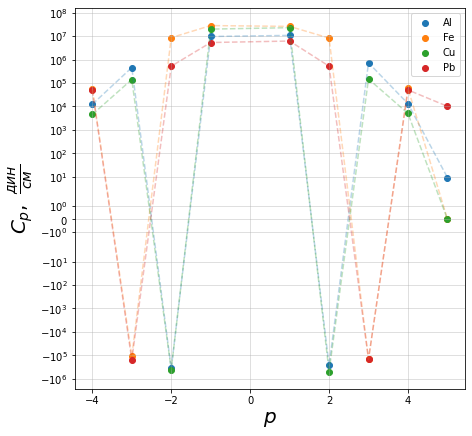

In [178]:
fig, ax = plt.subplots(figsize=(7, 7))
for material in materials:
    ax.plot(c_p_data[material]['p'], c_p_data[material]['c_p'], alpha=0.3, ls='--')
    ax.scatter(c_p_data[material]['p'], c_p_data[material]['c_p'], label=material)
ax.set_ylabel(r'$C_p,~\frac{дин}{см}$', fontsize=20)
ax.set_xlabel('$p$', fontsize=20)
ax.set_yscale('symlog')
ax.grid(which='major', alpha=0.5)
ax.legend()

plt.savefig(f'graphs/c_p.pdf')
plt.show()

In [179]:
sym_c_p_data = {material:compute_symmetric_c_p(material, c_p_data[material]) for material in materials}

concat_с_p(sym_c_p_data)

,p,c_p_Al,c_p_Fe,c_p_Cu,c_p_Pb
0,1,1.021297e+07,2.712736e+07,2.144415e+07,5.754086e+06
1,2,-3.193611e+05,8.454718e+06,-4.527408e+05,5.219574e+05
2,3,5.914651e+05,-1.289180e+05,1.442960e+05,-1.522124e+05
3,4,1.268588e+04,5.673185e+04,4.762036e+03,4.965406e+04
4,5,9.230187e+00,-1.500866e-08,4.606737e-10,1.011755e+04


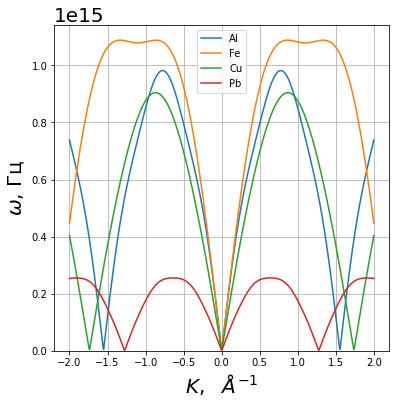

In [180]:
x = np.linspace(-2, 2, 500)

fig, ax = plt.subplots(figsize=(6, 6))
ax.grid()

for material in materials:
    c_p_broadcast = sym_c_p_data[material]['c_p'].values[np.newaxis, ...]
    p_broadcast = sym_c_p_data[material]['p'].values[np.newaxis, ...]
    x_broadcast = x[..., np.newaxis]
    
    omega_2 = np.sum(c_p_broadcast*(1-np.cos(p_broadcast*x_broadcast*lattice_constants[material])), axis=1)
    omega_2 *= 2/masses[material]
    y = np.sqrt(omega_2)

    ax.plot(x, y, label=material)
    
ax.set_ylim(0)
ax.set_xlabel(r'$K,~~\AA^{-1}$', fontsize=20)
ax.set_ylabel(r'$\omega$, Гц', fontsize=20)
ax.legend()
ax.xaxis.get_offset_text().set_fontsize(20)
ax.yaxis.get_offset_text().set_fontsize(20)

plt.savefig(f'graphs/omega2_k.pdf')
plt.show()

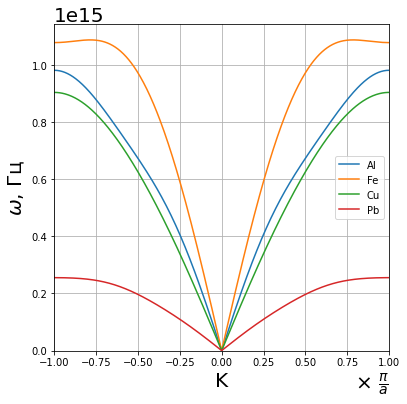

In [181]:
x = np.linspace(-1, 1, 500)

fig, ax = plt.subplots(figsize=(6, 6))
ax.grid()

for material in materials:
    c_p_broadcast = sym_c_p_data[material]['c_p'].values[np.newaxis, ...]
    p_broadcast = sym_c_p_data[material]['p'].values[np.newaxis, ...]
    x_broadcast = x[..., np.newaxis]
    
    omega_2 = np.sum(c_p_broadcast*(1-np.cos(p_broadcast*x_broadcast*np.pi)), axis=1)
    omega_2 *= 2/masses[material]
    y = np.sqrt(omega_2)

    ax.plot(x, y, label=material)
    
ax.set_xlim(-1, 1)
ax.set_ylim(0)
ax.set_xlabel('K', fontsize=20)
ax.set_ylabel(r'$\omega$, Гц', fontsize=20)
ax.legend()
ax.xaxis.get_major_formatter().get_offset = lambda: r"$\times ~ \frac{\pi}{a}$"
ax.xaxis.get_offset_text().set_fontsize(20)
ax.yaxis.get_offset_text().set_fontsize(20)

plt.savefig(f'graphs/omega2_k_scaled.pdf')
plt.show()

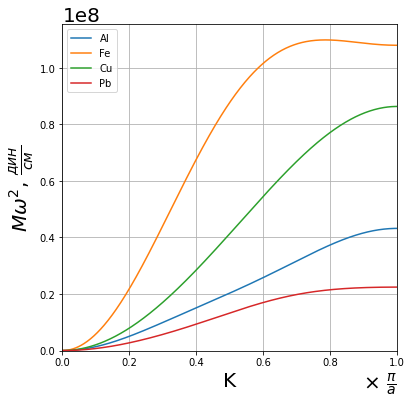

In [182]:
x = np.linspace(0, 1, 500)

fig, ax = plt.subplots(figsize=(6, 6))
ax.grid()

for material in materials:
    c_p_broadcast = sym_c_p_data[material]['c_p'].values[np.newaxis, ...]
    p_broadcast = sym_c_p_data[material]['p'].values[np.newaxis, ...]
    x_broadcast = x[..., np.newaxis]
    
    omega_2 = np.sum(c_p_broadcast*(1-np.cos(p_broadcast*x_broadcast*np.pi)), axis=1)
    omega_2 *= 2/masses[material]
    y = omega_2*masses[material]

    ax.plot(x, y, label=material)
    
ax.set_xlim(0, 1)
ax.set_ylim(0)
ax.set_xlabel('K', fontsize=20)
ax.set_ylabel(r'$M\omega^2$, $\frac{дин}{см}$', fontsize=20)
ax.legend()
ax.xaxis.get_major_formatter().get_offset = lambda: r"$\times ~ \frac{\pi}{a}$"
ax.xaxis.get_offset_text().set_fontsize(20)
ax.yaxis.get_offset_text().set_fontsize(20)

plt.savefig(f'graphs/M_omega2_k_scaled.pdf')
plt.show()

In [183]:
from matplotlib import animation
from IPython.display import HTML
from IPython.display import display
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**10
n_steps = 200  # 200 steps calculating in ~1 min

fig = plt.figure(figsize=(8,8))
ax = fig.gca(projection='3d')


material = 'Al'

scatter = ax.scatter3D(data[material]['init']['xs'], 
                       data[material]['init']['ys'], 
                       data[material]['init']['zs'], 
                       color='tab:orange', alpha=0.5)
scatter_new = ax.scatter3D(data[material]['displace']['xs'], 
                           data[material]['displace']['ys'], 
                           data[material]['displace']['zs'], 
                           color='tab:blue', alpha=0.5)

def animate(i):
    ax.view_init(30, 20+i*0.5+40)

    return ()

# call the animator. blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate,
                               frames=n_steps, interval=30, blit=True)

# use if you want to save it into mp4
# Writer = animation.writers['ffmpeg']
# writer = Writer(fps=30, metadata=dict(artist='Me'), bitrate=-1, extra_args=['-vcodec', 'libx264'])
# anim.save('3d-animated.mp4', writer=writer)

# display in IPython
display(HTML(anim.to_jshtml()))
plt.close()

d:\programs\python 3.7.4\lib\site-packages\ipykernel_launcher.py:9: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  if __name__ == '__main__':


In [282]:
import plotly
import plotly.graph_objs as go

# plotly.offline.init_notebook_mode()

material = 'Al'

scatter = go.Scatter3d(
    x=data[material]['init']['xs'],
    y=data[material]['init']['ys'],
    z=data[material]['init']['zs'],
    mode='markers',
    marker={
        'size': 4,
        'opacity': 0.8,
    }
)

data = [scatter]

plot_figure = go.Figure(data=data, layout=layout)
plotly.offline.iplot(plot_figure)